In [1]:
# data downloaded from https://www.kaggle.com/camnugent/california-housing-prices

In [2]:
# Load modules
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_samples, silhouette_score
from sklearn.cluster import KMeans

In [10]:
df = pd.read_csv('housing.csv')

In [4]:
df.head()

,longitude,latitude,housing_median_age,total_rooms,total_bedrooms,population,households,median_income,median_house_value,ocean_proximity
0,-122.23,37.88,41.0,880.0,129.0,322.0,126.0,8.3252,452600.0,NEAR BAY
1,-122.22,37.86,21.0,7099.0,1106.0,2401.0,1138.0,8.3014,358500.0,NEAR BAY
2,-122.24,37.85,52.0,1467.0,190.0,496.0,177.0,7.2574,352100.0,NEAR BAY
3,-122.25,37.85,52.0,1274.0,235.0,558.0,219.0,5.6431,341300.0,NEAR BAY
4,-122.25,37.85,52.0,1627.0,280.0,565.0,259.0,3.8462,342200.0,NEAR BAY


In [6]:
df.shape

(20640, 10)

In [5]:
df.isna().sum()

longitude               0
latitude                0
housing_median_age      0
total_rooms             0
total_bedrooms        207
population              0
households              0
median_income           0
median_house_value      0
ocean_proximity         0
dtype: int64

In [49]:
dfi = df[['longitude', 'latitude', 'population', 'ocean_proximity']]
dft = df[['longitude', 'latitude']]

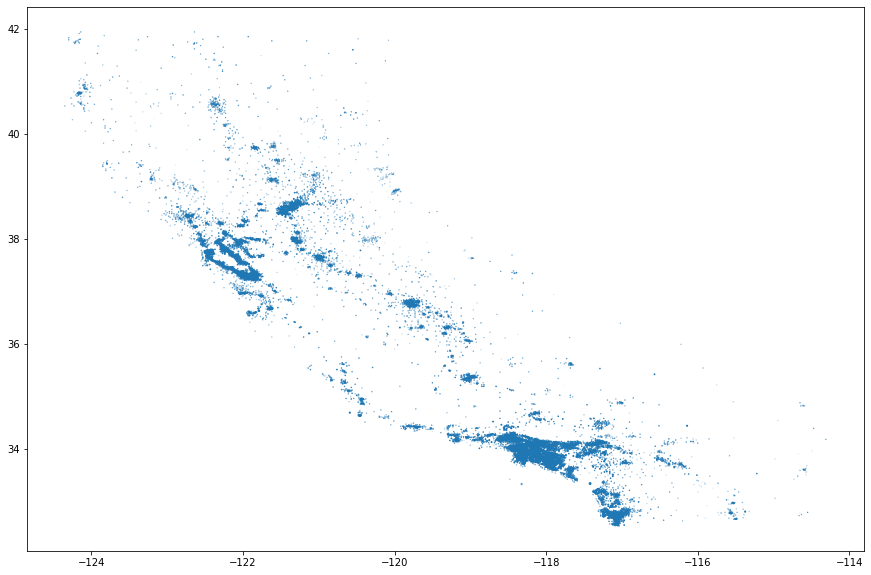

In [77]:
plt.figure(figsize=(15,10))
plt.scatter(df.longitude, df.latitude, s=df.population*0.0001)

In [63]:
# Wstępna ilość klastrów
clust_dict = {}
range_n_clusters = list(range(2,36))

for n in range_n_clusters:
    clusterer = KMeans(n_clusters=n, random_state=2020)
    cluster_labels = clusterer.fit_predict(dft)

    silhouette_avg = silhouette_score(dft, cluster_labels)
    clust_dict[n] = silhouette_avg
    print(f'ILość klastów: {n} średnia wartość Silhouette {silhouette_avg}')

ILość klastów: 2 średnia wartość Silhouette 0.7562423686789216
ILość klastów: 3 średnia wartość Silhouette 0.6471818705345762
ILość klastów: 4 średnia wartość Silhouette 0.6009839451423112
ILość klastów: 5 średnia wartość Silhouette 0.5831524612006248
ILość klastów: 6 średnia wartość Silhouette 0.5697770729304624
ILość klastów: 7 średnia wartość Silhouette 0.5720972780709692
ILość klastów: 8 średnia wartość Silhouette 0.5419827018126001
ILość klastów: 9 średnia wartość Silhouette 0.517591963815449
ILość klastów: 10 średnia wartość Silhouette 0.4970261018727566
ILość klastów: 11 średnia wartość Silhouette 0.44508593706016175
ILość klastów: 12 średnia wartość Silhouette 0.4805411344007366
ILość klastów: 13 średnia wartość Silhouette 0.457514304249542
ILość klastów: 14 średnia wartość Silhouette 0.5193871440395532
ILość klastów: 15 średnia wartość Silhouette 0.4788131701267084
ILość klastów: 16 średnia wartość Silhouette 0.4895132745020367
ILość klastów: 17 średnia wartość Silhouette 0.48

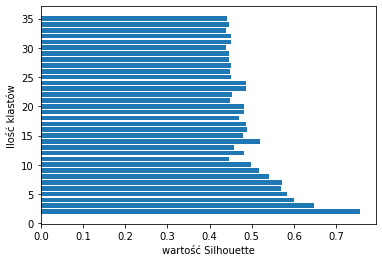

In [66]:
plt.xlabel('wartość Silhouette')
plt.ylabel('Ilość klastów')
plt.barh(*zip(*sorted(clust_dict.items())));


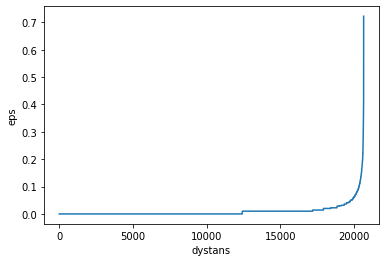

In [68]:
neighbors = NearestNeighbors(n_neighbors=50)
neighbors_fit = neighbors.fit(dft)
distances, indices = neighbors_fit.kneighbors(dft)
distances = np.sort(distances, axis=0)
distances = distances[:,1]

plt.xlabel('dystans')
plt.ylabel('eps')
plt.plot(distances);

In [ ]:
# eps wstępnie określony z zakresu < 0.01 - 0.1 >

In [69]:
zakres = np.linspace(0.01,0.1,10)
for i in zakres:
    print(f'eps={i}')
    db = DBSCAN(eps=i, min_samples=15).fit(dft)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    print(f'Ilość klastów: {len(set(labels))}')
    silhouette_avg = silhouette_score(dft, labels)
    print(f'Wartość Silhouette {silhouette_avg}')
    print('-----')

eps=0.01
Ilość klastów: 113
Wartość Silhouette -0.6935498817679434
-----
eps=0.020000000000000004
Ilość klastów: 80
Wartość Silhouette -0.3623353693023727
-----
eps=0.030000000000000006
Ilość klastów: 78
Wartość Silhouette 0.04566996714285124
-----
eps=0.04000000000000001
Ilość klastów: 73
Wartość Silhouette 0.15369406655454554
-----
eps=0.05000000000000001
Ilość klastów: 68
Wartość Silhouette 0.12023677097025447
-----
eps=0.06000000000000001
Ilość klastów: 64
Wartość Silhouette 0.20934722022090838
-----
eps=0.07
Ilość klastów: 55
Wartość Silhouette 0.25126953552557735
-----
eps=0.08
Ilość klastów: 50
Wartość Silhouette 0.23086903907272407
-----
eps=0.09000000000000001
Ilość klastów: 45
Wartość Silhouette 0.2652246393266694
-----
eps=0.1
Ilość klastów: 36
Wartość Silhouette 0.2943278384694712
-----


In [70]:
zakres_min_samples = [15,20,25,30,35,40,45,50,55,60,65]
for i in zakres_min_samples:
    print(f'min_samples={i}')
    db = DBSCAN(eps=0.1, min_samples=i).fit(dft)
    core_samples_mask = np.zeros_like(db.labels_, dtype=bool)
    core_samples_mask[db.core_sample_indices_] = True
    labels = db.labels_

    #print(set(labels))
    silhouette_avg = silhouette_score(dft, labels)
    print(f'Dla min_samples = {i} ilość klastów to {len(set(labels))}')
    print(silhouette_avg)
    print('----')

min_samples=15
Dla min_samples = 15 ilość klastów to 36
0.2943278384694712
----
min_samples=20
Dla min_samples = 20 ilość klastów to 35
0.3031094627428103
----
min_samples=25
Dla min_samples = 25 ilość klastów to 32
0.2539953082494746
----
min_samples=30
Dla min_samples = 30 ilość klastów to 32
0.2558018233379855
----
min_samples=35
Dla min_samples = 35 ilość klastów to 33
0.2473611761029623
----
min_samples=40
Dla min_samples = 40 ilość klastów to 32
0.24215900282343883
----
min_samples=45
Dla min_samples = 45 ilość klastów to 25
0.23309101368086638
----
min_samples=50
Dla min_samples = 50 ilość klastów to 26
0.23248770603963387
----
min_samples=55
Dla min_samples = 55 ilość klastów to 22
0.2209334067506156
----
min_samples=60
Dla min_samples = 60 ilość klastów to 22
0.21958320030458658
----
min_samples=65
Dla min_samples = 65 ilość klastów to 20
0.22537371423629757
----


In [71]:
dbscan = DBSCAN(eps=0.1, min_samples=20)
model = dbscan.fit(dft)
results = list(model.labels_)
unique_labels = list(set(results))
unique_labels


for label in unique_labels:
    print(label, results.count(label))

print(f'Ilość klastrów: {len(unique_labels)}')
silhouette_score(dft, results)

0 4729
1 47
2 42
3 43
4 46
5 37
6 561
7 83
8 80
9 231
10 24
11 35
12 38
13 8852
14 98
15 35
16 31
17 796
18 863
19 25
20 118
21 25
22 1580
23 23
24 152
25 24
26 162
27 43
28 99
29 57
30 87
31 20
32 192
33 50
-1 1312
Ilość klastrów: 35


0.3031094627428103

In [73]:
dft['results'] = results

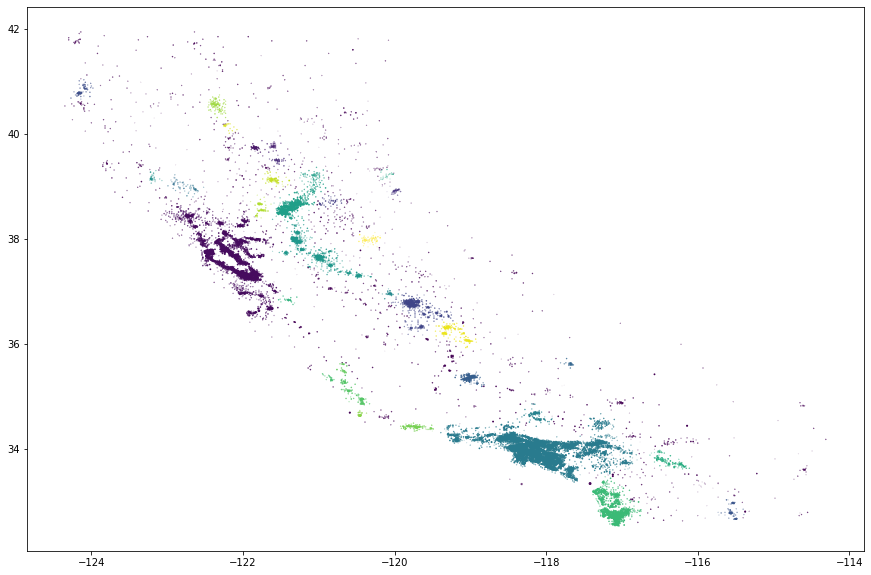

In [78]:
plt.figure(figsize=(15,10))
plt.scatter(df.longitude, df.latitude, s=df.population*0.0001, c=dft.results, cmap='viridis');